In [1]:
### Imports, some helper functions
import numpy as np
import xarray as xr
import glob
import os
import hashlib
import dask
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib import colors
from matplotlib import colormaps
from matplotlib import cm
from dask.distributed import Client, LocalCluster
import seaborn as sns
import pprint
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from pprint import pp
from datetime import date

# let's test for now...
from xarray_cacher import *

In [2]:
### Data loading
# Corrected lat-lon grid will be handled separately 
model_grid = xr.open_mfdataset("/data/ycheng46/NNA/data/alaska_climate_region.nc")
static_lat2d = model_grid.lat.values
static_lon2d = model_grid.lon.values % 360

# DAILY snow
snow_paths = ["/data/shared_data/NNA/NNA.4km.hERA5.1989.003/snow_d/*.nc",
              "/data/shared_data/NNA/NNA.4km.fPGWh.2033.004/snow_d/*.nc",
              "/data/shared_data/NNA/NNA.4km.fPGWm.2033.005/snow_d/*.nc" ]

better_h2osno_paths = ["/data/shared_data/NNA/NNA.4km.hERA5.1989.003/swe_d/*.nc",
                        "/data/shared_data/NNA/NNA.4km.fPGWh.2033.004/swe_d/*.nc",
                        "/data/shared_data/NNA/NNA.4km.fPGWm.2033.005/swe_d/*.nc" ]

## TODO: get the snow ratio data you calculated
snow_ratio_paths = ['/data/nflores3/outputs/*_P.nc',
                   '/data/nflores3/outputs/*_H.nc',
                   '/data/nflores3/outputs/*_M.nc']

precip_ratio_paths = ['/data/nflores3/outputs_merged/*_P.nc',
                   '/data/nflores3/outputs_merged/*_H.nc',
                   '/data/nflores3/outputs_merged/*_M.nc']

snow_P, snow_H, snow_M = unpacker(snow_paths, "SNOW")
better_h2osno_P, better_h2osno_H, better_h2osno_M = unpacker(better_h2osno_paths, "H2OSNO")
snow_ratio_P, snow_ratio_H, snow_ratio_M = unpacker_chunkless(snow_ratio_paths, "snow_ratio")
precip_ratio_P, precip_ratio_H, precip_ratio_M = unpacker_chunkless(precip_ratio_paths, "precip_ratio")

In [3]:
### Data editing

## Constants
seconds_per_year = 365.25 * 86400
seconds_per_season = 90.25 * 86400

## Helpers for our cache functions    
def compute_annual_generic(ds):
    return ds.groupby("time.year").mean(dim="time", skipna=True, keep_attrs=True)

def compute_annual_runoff(ds):
    return ds.groupby("time.year").mean(dim="time", skipna=True, keep_attrs=True)

def compute_geo_average_future(ds):
    return ds.mean(dim=("lat", "lon"), skipna=True, keep_attrs=True).sel(year=slice(2034, 2064))

def compute_geo_average_historic(ds):
    return ds.mean(dim=("lat", "lon"), skipna=True, keep_attrs=True).sel(year=slice(1990, 2020))

def compute_layer_average_future(ds):
    return ds.mean(dim=("lat", "lon"), skipna=True, keep_attrs=True).sum(dim="levsoi").sel(year=slice(2034, 2064))

def compute_layer_average_historic(ds):
    return ds.mean(dim=("lat", "lon"), skipna=True, keep_attrs=True).sum(dim="levsoi").sel(year=slice(1990, 2020))

## Snow
total_snow_P = (snow_P) * seconds_per_year
total_snow_H = (snow_H) * seconds_per_year
total_snow_M = (snow_M) * seconds_per_year

annual_snow_P = cache_xarray(compute_annual_generic, total_snow_P, name_hint="annual_snow_P")
annual_snow_H = cache_xarray(compute_annual_generic, total_snow_H, name_hint="annual_snow_H")
annual_snow_M = cache_xarray(compute_annual_generic, total_snow_M, name_hint="annual_snow_M")

## Better snowmelt (snow water equivalent)
# In this case, we're just grouping, we have high enough precision where we want individual days
total_better_h2osno_P = better_h2osno_P
total_better_h2osno_H = better_h2osno_H
total_better_h2osno_M = better_h2osno_M

annual_better_h2osno_P = total_better_h2osno_P.groupby("time.year")
annual_better_h2osno_H = total_better_h2osno_H.groupby("time.year")
annual_better_h2osno_M = total_better_h2osno_M.groupby("time.year")

/home/nflores3/.conda/envs/nsf-env/lib/python3.9/site-packages/numpy/_core/_methods.py:52: RuntimeWarning: invalid value encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)
/home/nflores3/.conda/envs/nsf-env/lib/python3.9/site-packages/numpy/_core/_methods.py:52: RuntimeWarning: invalid value encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)
/home/nflores3/.conda/envs/nsf-env/lib/python3.9/site-packages/dask/core.py:127: RuntimeWarning: invalid value encountered in subtract
  return func(*(_execute_task(a, cache) for a in args))
/home/nflores3/.conda/envs/nsf-env/lib/python3.9/site-packages/numpy/_core/_methods.py:52: RuntimeWarning: invalid value encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)
/home/nflores3/.conda/envs/nsf-env/lib/python3.9/site-packages/dask/core.py:127: RuntimeWarning: invalid value encountered in subtract
  return func(*(_execute_task(a, cache) for a in args

/home/nflores3/.conda/envs/nsf-env/lib/python3.9/site-packages/matplotlib_inline/backend_inline.py:27: UserWarning: The Figure parameters 'layout' and 'constrained_layout' cannot be used together. Please use 'layout' only.
  return new_figure_manager_given_figure(num, FigureClass(*args, **kwargs))


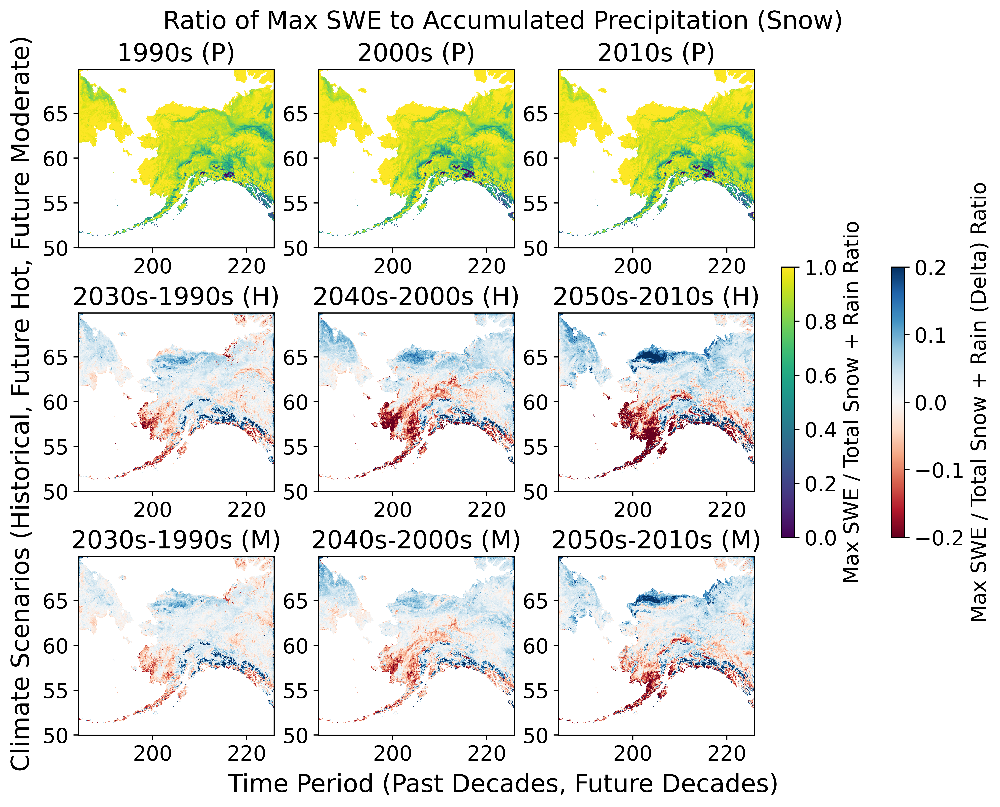

In [4]:
### Data loading: cached numpy results

# TODO: some are not evenly sized (the last one of the futures), not quite sure what to do about that

# 10-year slices (P)
# 1990-1991 to 1999-2000
# 2000-2001 to 2009-2010
# 2010-2011 to 2019-2020

snow_slice_1990s_P = snow_ratio_P.sel(snow_year=slice("1990-1991", "1999-2000")).mean(dim="snow_year")
snow_slice_2000s_P = snow_ratio_P.sel(snow_year=slice("2000-2001", "2009-2010")).mean(dim="snow_year")
snow_slice_2010s_P = snow_ratio_P.sel(snow_year=slice("2010-2011", "2019-2020")).mean(dim="snow_year")

snow_historical = [ snow_slice_1990s_P, snow_slice_2000s_P, snow_slice_2010s_P ]
snow_historical_titles = [ "1990s (P)", "2000s (P)", "2010s (P)" ]

# used for making the diff maps
snow_historical_mean = xr.concat(snow_historical, dim='time').mean(dim='time')

# 10-year slices (H)
# 2034-2035 to 2044-2045
# 2045-2046 to 2054-2055
# 2055-2056 to 2063-2064 

snow_slice_2030s_H = snow_ratio_H.sel(snow_year=slice("2034-2035", "2044-2045")).mean(dim="snow_year")
snow_slice_2040s_H = snow_ratio_H.sel(snow_year=slice("2045-2026", "2054-2055")).mean(dim="snow_year")
snow_slice_2050s_H = snow_ratio_H.sel(snow_year=slice("2055-2056", "2063-2064")).mean(dim="snow_year")

snow_hots = [ snow_slice_2030s_H, snow_slice_2040s_H, snow_slice_2050s_H ]
snow_hots_titles = [ "2030s-1990s (H)", "2040s-2000s (H)", "2050s-2010s (H)" ]

# 10-year slices (M)
# 2034-2035 to 2044-2045
# 2045-2046 to 2054-2055
# 2055-2056 to 2063-2064

snow_slice_2030s_M = snow_ratio_M.sel(snow_year=slice("2034-2035", "2044-2045")).mean(dim="snow_year")
snow_slice_2040s_M = snow_ratio_M.sel(snow_year=slice("2045-2026", "2054-2055")).mean(dim="snow_year")
snow_slice_2050s_M = snow_ratio_M.sel(snow_year=slice("2055-2056", "2063-2064")).mean(dim="snow_year")

snow_moderates = [snow_slice_2030s_M, snow_slice_2040s_M, snow_slice_2050s_M ]
snow_moderates_titles = [ "2030s-1990s (M)", "2040s-2000s (M)", "2050s-2010s (M)" ]

all_vals = np.concatenate([
    snow_slice_2030s_M.values, 
    snow_slice_2040s_M.values, 
    snow_slice_2050s_M.values,
    snow_slice_2030s_H.values, 
    snow_slice_2040s_H.values, 
    snow_slice_2050s_H.values,
    snow_slice_1990s_P.values, 
    snow_slice_2000s_P.values, 
    snow_slice_2010s_P.values
])

# remember: .plot(vmax=1)
plt.rc('font', size=15)
fig, axs = plt.subplots(ncols=3, nrows=3, layout="constrained", figsize=(10, 8), dpi=600, constrained_layout=True)
fig.suptitle('Ratio of Max SWE to Accumulated Precipitation (Snow)')
fig.supxlabel('Time Period (Past Decades, Future Decades)')
fig.supylabel('Climate Scenarios (Historical, Future Hot, Future Moderate)')

for i, snow_da in enumerate(snow_historical):
    row, col = divmod(i, 3)
    data = snow_da.values
    lat = snow_da.lat.values
    lon = snow_da.lon.values

    mesh = axs[row, col].pcolormesh(lon, lat, data, cmap='viridis', vmin=0, vmax=1)
    axs[row, col].set_title(snow_historical_titles[i])
    axs[row, col].set_ylabel("")
    axs[row, col].set_xlabel("")

for i, snow_da in enumerate(snow_hots):
    row, col = divmod(i + 3, 3)
    diff = snow_da.values - snow_historical_mean
    lat = snow_da.lat.values
    lon = snow_da.lon.values

    mesh = axs[row, col].pcolormesh(lon, lat, diff, cmap='RdBu', vmin=-0.2, vmax=0.2)
    axs[row, col].set_title(snow_hots_titles[i])
    axs[row, col].set_ylabel("")
    axs[row, col].set_xlabel("")

for i, snow_da in enumerate(snow_moderates):
    row, col = divmod(i + 6, 3)
    diff = snow_da.values - snow_historical_mean
    lat = snow_da.lat.values
    lon = snow_da.lon.values

    mesh = axs[row, col].pcolormesh(lon, lat, diff, cmap='RdBu', vmin=-0.2, vmax=0.2)
    axs[row, col].set_title(snow_moderates_titles[i])
    axs[row, col].set_xlabel('')
    axs[row, col].set_ylabel('')

norm = colors.Normalize(vmin=-0.2, vmax=0.2)
sm = cm.ScalarMappable(norm=norm, cmap='RdBu')
sm.set_array([])

norm_top = colors.Normalize(vmin=0, vmax=1)
sm_top = cm.ScalarMappable(norm=norm_top, cmap='viridis')
sm_top.set_array([])

fig.colorbar(sm, ax=axs, orientation='vertical', fraction=0.02, pad=0.04, label="Max SWE / Total Snow + Rain (Delta) Ratio")
fig.colorbar(sm_top, ax=axs, orientation='vertical', fraction=0.02, pad=0.04, label="Max SWE / Total Snow + Rain Ratio")
#fig.colorbar(label="Snow Runoff Ratio", extend="max")

## saving this work to disk
os.makedirs("snow_to_runoff_ratio", exist_ok=True)
plt.savefig(f"snow_to_runoff_ratio/plot-snow-only.png")

/home/nflores3/.conda/envs/nsf-env/lib/python3.9/site-packages/matplotlib_inline/backend_inline.py:27: UserWarning: The Figure parameters 'layout' and 'constrained_layout' cannot be used together. Please use 'layout' only.
  return new_figure_manager_given_figure(num, FigureClass(*args, **kwargs))
/tmp/ipykernel_1959602/2139910525.py:77: RuntimeWarning: invalid value encountered in subtract
  diff = precip_da.values - precip_historical_mean.values
/tmp/ipykernel_1959602/2139910525.py:88: RuntimeWarning: invalid value encountered in subtract
  diff = precip_da.values - precip_historical_mean.values


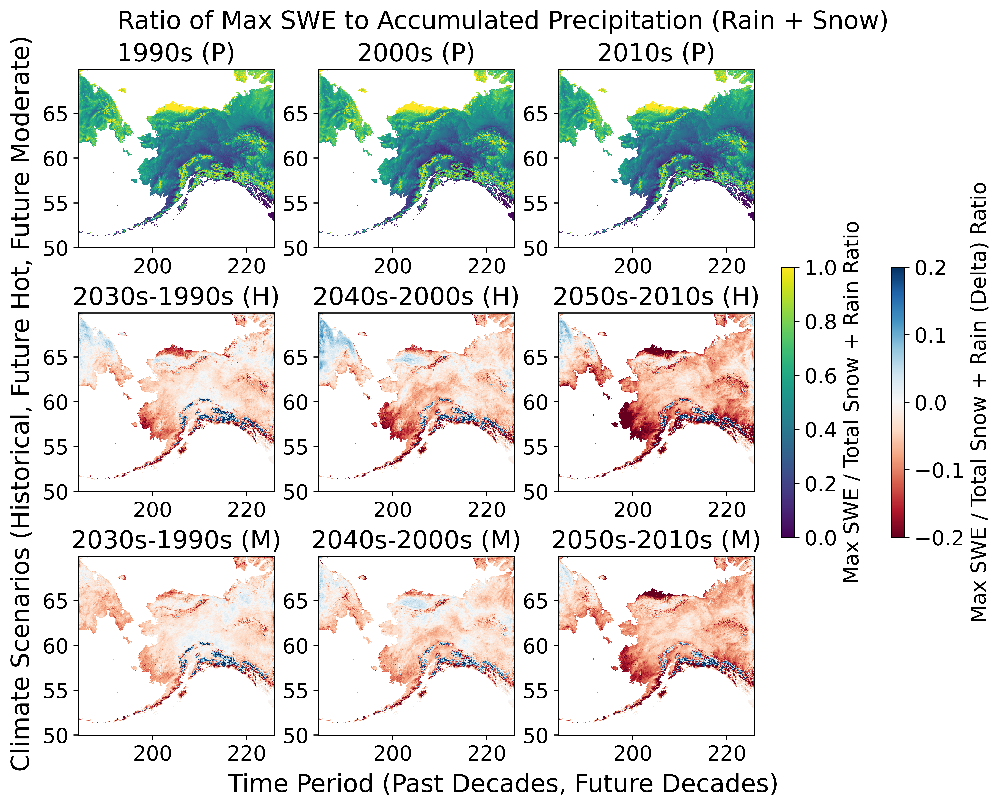

In [5]:

### Data loading: cached numpy results

# TODO: some are not evenly sized (the last one of the futures), not quite sure what to do about that

# 10-year slices (P)
# 1990-1991 to 1999-2000
# 2000-2001 to 2009-2010
# 2010-2011 to 2019-2020

precip_slice_1990s_P = precip_ratio_P.sel(precip_year=slice("1990-1991", "1999-2000")).mean(dim="precip_year")
precip_slice_2000s_P = precip_ratio_P.sel(precip_year=slice("2000-2001", "2009-2010")).mean(dim="precip_year")
precip_slice_2010s_P = precip_ratio_P.sel(precip_year=slice("2010-2011", "2019-2020")).mean(dim="precip_year")

precip_historical = [ precip_slice_1990s_P, precip_slice_2000s_P, precip_slice_2010s_P ]
precip_historical_titles = [ "1990s (P)", "2000s (P)", "2010s (P)" ]

# used for making the diff maps
precip_historical_mean = xr.concat(precip_historical, dim='time').mean(dim='time')

# 10-year slices (H)
# 2034-2035 to 2044-2045
# 2045-2046 to 2054-2055
# 2055-2056 to 2063-2064 

precip_slice_2030s_H = precip_ratio_H.sel(precip_year=slice("2034-2035", "2044-2045")).mean(dim="precip_year")
precip_slice_2040s_H = precip_ratio_H.sel(precip_year=slice("2045-2026", "2054-2055")).mean(dim="precip_year")
precip_slice_2050s_H = precip_ratio_H.sel(precip_year=slice("2055-2056", "2063-2064")).mean(dim="precip_year")

precip_hots = [ precip_slice_2030s_H, precip_slice_2040s_H, precip_slice_2050s_H ]
precip_hots_titles = [ "2030s-1990s (H)", "2040s-2000s (H)", "2050s-2010s (H)" ]

# 10-year slices (M)
# 2034-2035 to 2044-2045
# 2045-2046 to 2054-2055
# 2055-2056 to 2063-2064

precip_slice_2030s_M = precip_ratio_M.sel(precip_year=slice("2034-2035", "2044-2045")).mean(dim="precip_year")
precip_slice_2040s_M = precip_ratio_M.sel(precip_year=slice("2045-2026", "2054-2055")).mean(dim="precip_year")
precip_slice_2050s_M = precip_ratio_M.sel(precip_year=slice("2055-2056", "2063-2064")).mean(dim="precip_year")

precip_moderates = [precip_slice_2030s_M, precip_slice_2040s_M, precip_slice_2050s_M ]
precip_moderates_titles = [ "2030s-1990s (M)", "2040s-2000s (M)", "2050s-2010s (M)" ]

all_vals = np.concatenate([
    precip_slice_2030s_M.values, 
    precip_slice_2040s_M.values, 
    precip_slice_2050s_M.values,
    precip_slice_2030s_H.values, 
    precip_slice_2040s_H.values, 
    precip_slice_2050s_H.values,
    precip_slice_1990s_P.values, 
    precip_slice_2000s_P.values, 
    precip_slice_2010s_P.values
])

# remember: .plot(vmax=1)

plt.rc('font', size=15)
fig, axs = plt.subplots(ncols=3, nrows=3, layout="constrained", figsize=(10, 8), dpi=600, constrained_layout=True)
fig.suptitle('Ratio of Max SWE to Accumulated Precipitation (Rain + Snow)')
fig.supxlabel('Time Period (Past Decades, Future Decades)')
fig.supylabel('Climate Scenarios (Historical, Future Hot, Future Moderate)')

for i, precip_da in enumerate(precip_historical):
    row, col = divmod(i, 3)
    data = precip_da.values
    lat = precip_da.lat.values
    lon = precip_da.lon.values

    mesh = axs[row, col].pcolormesh(lon, lat, data, cmap='viridis', vmin=0, vmax=1)
    axs[row, col].set_title(precip_historical_titles[i])
    axs[row, col].set_ylabel("")
    axs[row, col].set_xlabel("")

for i, precip_da in enumerate(precip_hots):
    row, col = divmod(i + 3, 3)
    diff = precip_da.values - precip_historical_mean.values
    lat = precip_da.lat.values
    lon = precip_da.lon.values

    mesh = axs[row, col].pcolormesh(lon, lat, diff, cmap='RdBu', vmin=-0.2, vmax=0.2)
    axs[row, col].set_title(precip_hots_titles[i])
    axs[row, col].set_ylabel("")
    axs[row, col].set_xlabel("")

for i, precip_da in enumerate(precip_moderates):
    row, col = divmod(i + 6, 3)
    diff = precip_da.values - precip_historical_mean.values
    lat = precip_da.lat.values
    lon = precip_da.lon.values

    mesh = axs[row, col].pcolormesh(lon, lat, diff, cmap='RdBu', vmin=-0.2, vmax=0.2)
    axs[row, col].set_title(precip_moderates_titles[i])
    axs[row, col].set_xlabel('')
    axs[row, col].set_ylabel('')

norm = colors.Normalize(vmin=-0.2, vmax=0.2)
sm = cm.ScalarMappable(norm=norm, cmap='RdBu')
sm.set_array([])

norm_top = colors.Normalize(vmin=0, vmax=1)
sm_top = cm.ScalarMappable(norm=norm_top, cmap='viridis')
sm_top.set_array([])

fig.colorbar(sm, ax=axs, orientation='vertical', fraction=0.02, pad=0.04, label="Max SWE / Total Snow + Rain (Delta) Ratio")
fig.colorbar(sm_top, ax=axs, orientation='vertical', fraction=0.02, pad=0.04, label="Max SWE / Total Snow + Rain Ratio")
#fig.colorbar(label="Snow Runoff Ratio", extend="max")
type(axs[2, 1])

## saving this work to disk
os.makedirs("snow_to_runoff_ratio", exist_ok=True)
plt.savefig(f"snow_to_runoff_ratio/plot-snow-and-rain.png")

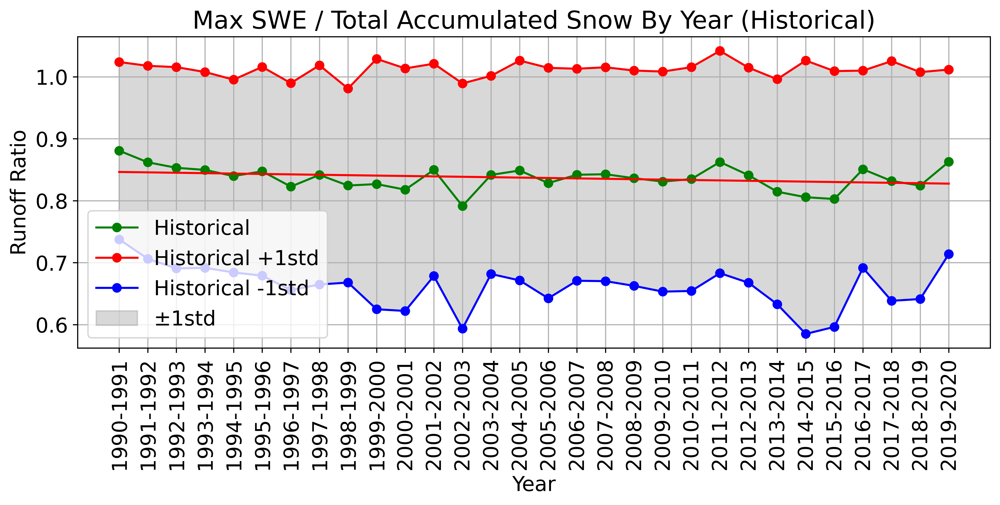

In [6]:
### Data visualization: line graphs
# TODO: without a clip I get some crazy numbers. remove .where((ds >= 0) & (ds <= 1)) to see more
snow_slice_norm_P = snow_ratio_P.where(~np.isinf(snow_ratio_P)).where((snow_ratio_P >= 0) & (snow_ratio_P <= 1)).sel(snow_year=slice("1990-1991", "2019-2020")).mean(dim=("lat", "lon"), skipna=True)
# this one below represents the standard deviation between points, a bit different
snow_slice_std_P = snow_ratio_P.where(~np.isinf(snow_ratio_P)).where((snow_ratio_P >= 0) & (snow_ratio_P <= 1)).sel(snow_year=slice("1990-1991", "2019-2020")).std(dim=("lat", "lon"), skipna=True)

plt.rc('font', size=15)
plt.figure(figsize=(10,5), dpi=600, constrained_layout=True)
plt.plot(snow_slice_norm_P.snow_year.values, snow_slice_norm_P.values, label="Historical", marker='o', linestyle='-', color='green')
plt.plot(snow_slice_norm_P.snow_year.values, snow_slice_norm_P.values + snow_slice_std_P.values, label="Historical +1std", marker='o', linestyle='-', color='red')
plt.plot(snow_slice_norm_P.snow_year.values, snow_slice_norm_P.values - snow_slice_std_P.values, label="Historical -1std", marker='o', linestyle='-', color='blue')
# TODO: this is bugged fix this
plt.fill_between(snow_slice_norm_P.snow_year.values, snow_slice_norm_P.values - snow_slice_std_P.values, snow_slice_norm_P.values + snow_slice_std_P.values, alpha=0.3, label="±1std", color='grey')

# TODO: fix this when you copy new model code
date_list_future = list(range(1990, 2020))
slope, intercept = np.polyfit(date_list_future, snow_slice_norm_P.values, 1)
line = slope * np.array(date_list_future) + intercept
plt.plot(snow_slice_norm_P.snow_year.values, line, color='red')

plt.title("Max SWE / Total Accumulated Snow By Year (Historical)")
plt.xticks(rotation=90) # needed for it not to look like trash
plt.xlabel("Year")
plt.ylabel("Runoff Ratio")
plt.legend()
plt.grid(True)

## saving this work to disk
os.makedirs("max_swe_div_snow", exist_ok=True)
plt.savefig(f"max_swe_div_snow/plot-historical.png")

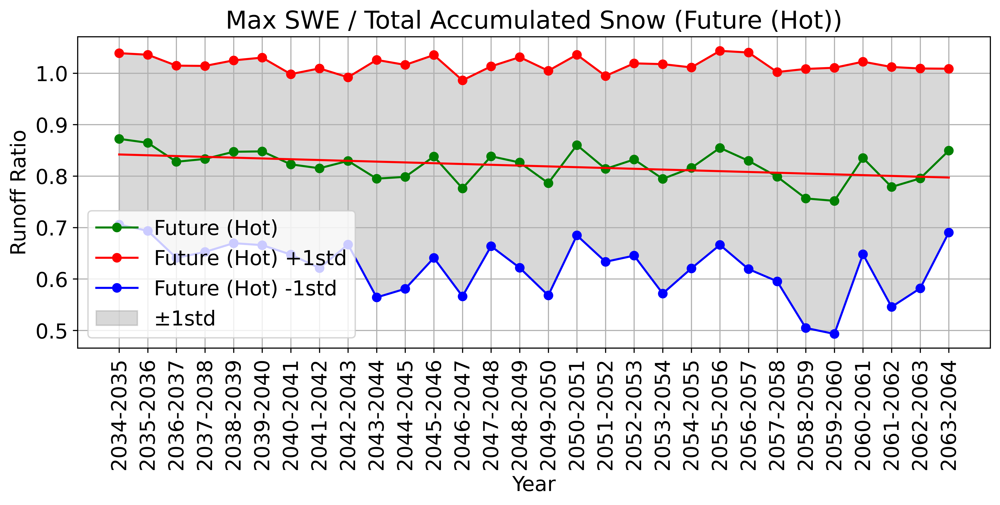

In [7]:
### Data visualization: line graphs
# TODO: without a clip I get some crazy numbers. remove .where((ds >= 0) & (ds <= 1)) to see more
snow_slice_norm_H = snow_ratio_H.where(~np.isinf(snow_ratio_H)).where((snow_ratio_H >= 0) & (snow_ratio_H <= 1)).sel(snow_year=slice("2034-2035", "2063-2064")).mean(dim=("lat", "lon"), skipna=True)
# this one below represents the standard deviation between points, a bit different
snow_slice_std_H = snow_ratio_H.where(~np.isinf(snow_ratio_H)).where((snow_ratio_H >= 0) & (snow_ratio_H <= 1)).sel(snow_year=slice("2034-2035", "2063-2064")).std(dim=("lat", "lon"), skipna=True)

plt.rc('font', size=15)
plt.figure(figsize=(10,5), dpi=600, constrained_layout=True)
plt.plot(snow_slice_norm_H.snow_year.values, snow_slice_norm_H.values, label="Future (Hot)", marker='o', linestyle='-', color='green')
plt.plot(snow_slice_norm_H.snow_year.values, snow_slice_norm_H.values + snow_slice_std_H.values, label="Future (Hot) +1std", marker='o', linestyle='-', color='red')
plt.plot(snow_slice_norm_H.snow_year.values, snow_slice_norm_H.values - snow_slice_std_H.values, label="Future (Hot) -1std", marker='o', linestyle='-', color='blue')
# TODO: this is bugged fix this
plt.fill_between(snow_slice_norm_H.snow_year.values, snow_slice_norm_H.values - snow_slice_std_H.values, snow_slice_norm_H.values + snow_slice_std_H.values, alpha=0.3, label="±1std", color='grey')

date_list_future = list(range(2034, 2064))
slope, intercept = np.polyfit(date_list_future, snow_slice_norm_H.values, 1)
line = slope * np.array(date_list_future) + intercept
plt.plot(snow_slice_norm_H.snow_year.values, line, color='red')

plt.title("Max SWE / Total Accumulated Snow (Future (Hot))")
plt.xticks(rotation=90) # needed for it not to look like trash
plt.xlabel("Year")
plt.ylabel("Runoff Ratio")
plt.legend()
plt.grid(True)

## saving this work to disk
os.makedirs("max_swe_div_snow", exist_ok=True)
plt.savefig(f"max_swe_div_snow/plot-future-hot.png")

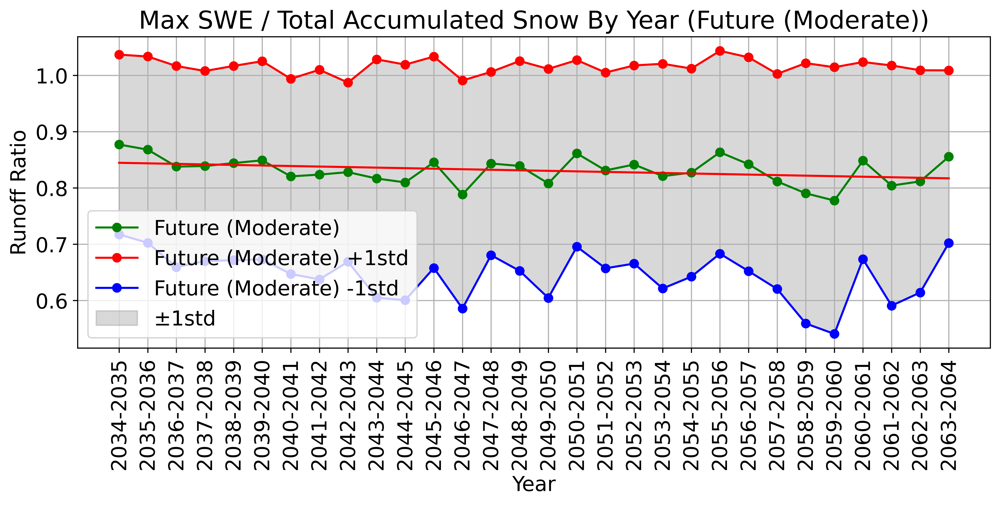

In [8]:
### Data visualization: line graphs
# TODO: without a clip I get some crazy numbers. remove .where((ds >= 0) & (ds <= 1)) to see more
snow_slice_norm_M = snow_ratio_M.where(~np.isinf(snow_ratio_M)).where((snow_ratio_M >= 0) & (snow_ratio_M <= 1)).sel(snow_year=slice("2034-2035", "2063-2064")).mean(dim=("lat", "lon"), skipna=True)
# this one below represents the standard deviation between points, a bit different
snow_slice_std_M = snow_ratio_M.where(~np.isinf(snow_ratio_M)).where((snow_ratio_M >= 0) & (snow_ratio_M <= 1)).sel(snow_year=slice("2034-2035", "2063-2064")).std(dim=("lat", "lon"), skipna=True)

plt.rc('font', size=15)
plt.figure(figsize=(10,5), dpi=600, constrained_layout=True)
plt.plot(snow_slice_norm_M.snow_year.values, snow_slice_norm_M.values, label="Future (Moderate)", marker='o', linestyle='-', color='green')
plt.plot(snow_slice_norm_M.snow_year.values, snow_slice_norm_M.values + snow_slice_std_M.values, label="Future (Moderate) +1std", marker='o', linestyle='-', color='red')
plt.plot(snow_slice_norm_M.snow_year.values, snow_slice_norm_M.values - snow_slice_std_M.values, label="Future (Moderate) -1std", marker='o', linestyle='-', color='blue')
# TODO: this is bugged fix this
plt.fill_between(snow_slice_norm_M.snow_year.values, snow_slice_norm_M.values - snow_slice_std_M.values, snow_slice_norm_M.values + snow_slice_std_M.values, alpha=0.3, label="±1std", color='grey')

date_list_future = list(range(2034, 2064))
slope, intercept = np.polyfit(date_list_future, snow_slice_norm_M.values, 1)
line = slope * np.array(date_list_future) + intercept
plt.plot(snow_slice_norm_M.snow_year.values, line, color='red')

plt.title("Max SWE / Total Accumulated Snow By Year (Future (Moderate))")
plt.xticks(rotation=90) # needed for it not to look like trash
plt.xlabel("Year")
plt.ylabel("Runoff Ratio")
plt.legend()
plt.grid(True)

## saving this work to disk
os.makedirs("max_swe_div_snow", exist_ok=True)
plt.savefig(f"max_swe_div_snow/plot-future-moderate.png")

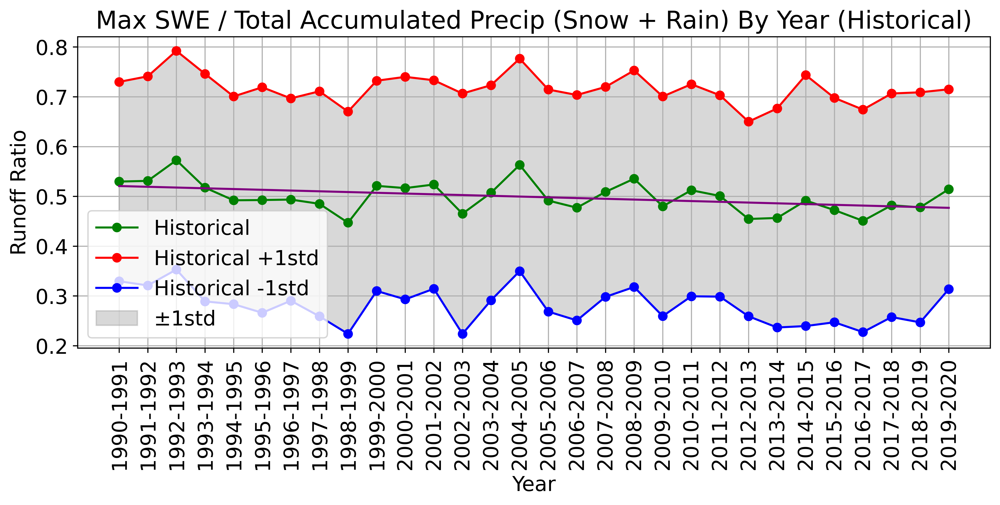

In [9]:
### Data visualization: line graphs
# TODO: without a clip I get some crazy numbers. remove .where((ds >= 0) & (ds <= 1)) to see more
precip_slice_norm_P = precip_ratio_P.where(~np.isinf(precip_ratio_P)).where((precip_ratio_P >= 0) & (precip_ratio_P <= 1)).sel(precip_year=slice("1990-1991", "2019-2020")).mean(dim=("lat", "lon"), skipna=True)
# this one below represents the standard deviation between points, a bit different
precip_slice_std_P = precip_ratio_P.where(~np.isinf(precip_ratio_P)).where((precip_ratio_P >= 0) & (precip_ratio_P <= 1)).sel(precip_year=slice("1990-1991", "2019-2020")).std(dim=("lat", "lon"), skipna=True)

plt.rc('font', size=15)
plt.figure(figsize=(10,5), dpi=600, constrained_layout=True)
plt.plot(precip_slice_norm_P.precip_year.values, precip_slice_norm_P.values, label="Historical", marker='o', linestyle='-', color='green')
plt.plot(precip_slice_norm_P.precip_year.values, precip_slice_norm_P.values + precip_slice_std_P.values, label="Historical +1std", marker='o', linestyle='-', color='red')
plt.plot(precip_slice_norm_P.precip_year.values, precip_slice_norm_P.values - precip_slice_std_P.values, label="Historical -1std", marker='o', linestyle='-', color='blue')
# TODO: this is bugged fix this
plt.fill_between(precip_slice_norm_P.precip_year.values, precip_slice_norm_P.values - precip_slice_std_P.values, precip_slice_norm_P.values + precip_slice_std_P.values, alpha=0.3, label="±1std", color='grey')

# TODO: fix this when you copy new model code
date_list_future = list(range(1990, 2020))
slope, intercept = np.polyfit(date_list_future, precip_slice_norm_P.values, 1)
line = slope * np.array(date_list_future) + intercept
plt.plot(precip_slice_norm_P.precip_year.values, line, color='purple')

plt.title("Max SWE / Total Accumulated Precip (Snow + Rain) By Year (Historical)")
plt.xticks(rotation=90) # needed for it not to look like trash
plt.xlabel("Year")
plt.ylabel("Runoff Ratio")
plt.legend()
plt.grid(True)

## saving this work to disk
os.makedirs("max_swe_div_snow_plus_rain", exist_ok=True)
plt.savefig(f"max_swe_div_snow_plus_rain/plot-historical.png")

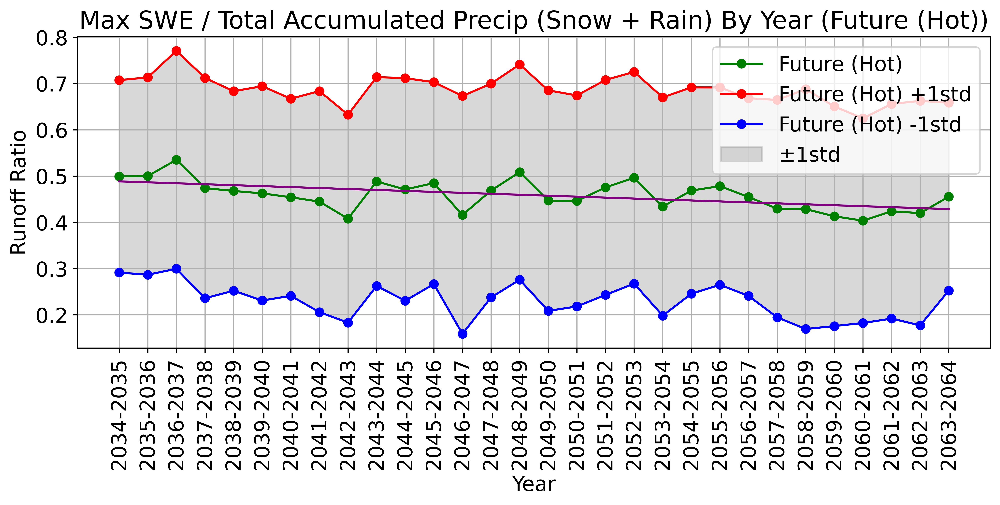

In [10]:
### Data visualization: line graphs
# TODO: without a clip I get some crazy numbers. remove .where((ds >= 0) & (ds <= 1)) to see more
precip_slice_norm_H = precip_ratio_H.where(~np.isinf(precip_ratio_H)).where((precip_ratio_H >= 0) & (precip_ratio_H <= 1)).sel(precip_year=slice("2034-2035", "2063-2064")).mean(dim=("lat", "lon"), skipna=True)
# this one below represents the standard deviation between points, a bit different
precip_slice_std_H = precip_ratio_H.where(~np.isinf(precip_ratio_H)).where((precip_ratio_H >= 0) & (precip_ratio_H <= 1)).sel(precip_year=slice("2034-2035", "2063-2064")).std(dim=("lat", "lon"), skipna=True)

plt.rc('font', size=15)
plt.figure(figsize=(10,5), dpi=600, constrained_layout=True)
plt.plot(precip_slice_norm_H.precip_year.values, precip_slice_norm_H.values, label="Future (Hot)", marker='o', linestyle='-', color='green')
plt.plot(precip_slice_norm_H.precip_year.values, precip_slice_norm_H.values + precip_slice_std_H.values, label="Future (Hot) +1std", marker='o', linestyle='-', color='red')
plt.plot(precip_slice_norm_H.precip_year.values, precip_slice_norm_H.values - precip_slice_std_H.values, label="Future (Hot) -1std", marker='o', linestyle='-', color='blue')
# TODO: this is bugged fix this
plt.fill_between(precip_slice_norm_H.precip_year.values, precip_slice_norm_H.values - precip_slice_std_H.values, precip_slice_norm_H.values + precip_slice_std_H.values, alpha=0.3, label="±1std", color='grey')

date_list_future = list(range(2034, 2064))
slope, intercept = np.polyfit(date_list_future, precip_slice_norm_H.values, 1)
line = slope * np.array(date_list_future) + intercept
plt.plot(precip_slice_norm_H.precip_year.values, line, color='purple')

plt.title("Max SWE / Total Accumulated Precip (Snow + Rain) By Year (Future (Hot))")
plt.xticks(rotation=90) # needed for it not to look like trash
plt.xlabel("Year")
plt.ylabel("Runoff Ratio")
plt.legend()
plt.grid(True)

## saving this work to disk
os.makedirs("max_swe_div_snow_plus_rain", exist_ok=True)
plt.savefig(f"max_swe_div_snow_plus_rain/plot-future-hot.png")

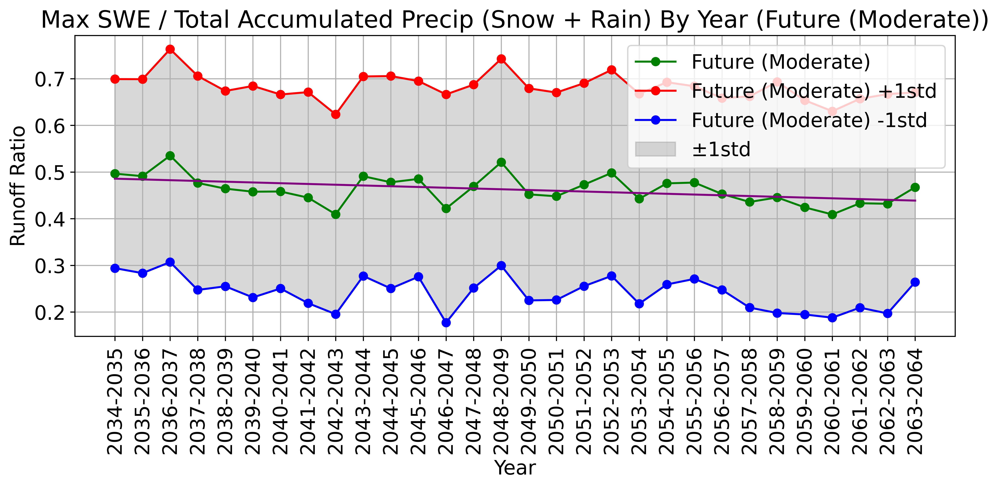

In [11]:
### Data visualization: line graphs
# TODO: without a clip I get some crazy numbers. remove .where((ds >= 0) & (ds <= 1)) to see more
precip_slice_norm_M = precip_ratio_M.where(~np.isinf(precip_ratio_M)).where((precip_ratio_M >= 0) & (precip_ratio_M <= 1)).sel(precip_year=slice("2034-2035", "2063-2064")).mean(dim=("lat", "lon"), skipna=True)
# this one below represents the standard deviation between points, a bit different
precip_slice_std_M = precip_ratio_M.where(~np.isinf(precip_ratio_M)).where((precip_ratio_M >= 0) & (precip_ratio_M <= 1)).sel(precip_year=slice("2034-2035", "2063-2064")).std(dim=("lat", "lon"), skipna=True)

plt.rc('font', size=15)
plt.figure(figsize=(10,5), dpi=600, constrained_layout=True)
plt.plot(precip_slice_norm_M.precip_year.values, precip_slice_norm_M.values, label="Future (Moderate)", marker='o', linestyle='-', color='green')
plt.plot(precip_slice_norm_M.precip_year.values, precip_slice_norm_M.values + precip_slice_std_M.values, label="Future (Moderate) +1std", marker='o', linestyle='-', color='red')
plt.plot(precip_slice_norm_M.precip_year.values, precip_slice_norm_M.values - precip_slice_std_M.values, label="Future (Moderate) -1std", marker='o', linestyle='-', color='blue')
# TODO: this is bugged fix this
plt.fill_between(precip_slice_norm_M.precip_year.values, precip_slice_norm_M.values - precip_slice_std_M.values, precip_slice_norm_M.values + precip_slice_std_M.values, alpha=0.3, label="±1std", color='grey')

date_list_future = list(range(2034, 2064))
slope, intercept = np.polyfit(date_list_future, precip_slice_norm_M.values, 1)
line = slope * np.array(date_list_future) + intercept
plt.plot(precip_slice_norm_M.precip_year.values, line, color='purple')

plt.title("Max SWE / Total Accumulated Precip (Snow + Rain) By Year (Future (Moderate))")
plt.xticks(rotation=90) # needed for it not to look like trash
plt.xlabel("Year")
plt.ylabel("Runoff Ratio")
plt.legend()
plt.grid(True)

## saving this work to disk
os.makedirs("max_swe_div_snow_plus_rain", exist_ok=True)
plt.savefig(f"max_swe_div_snow_plus_rain/plot-future-moderate.png")

In [12]:
region_dic = {1:"West Coast",
              2:"Aleutians",
              3:"Central Interior",
              4:"Northern Slope",
              5:"NE Interior",
              6:"SE Interior",
              7:"Cook Inlet",
              8:"NW Gulf",
              9:"Bristol Bay",
              10:"North Panhandle",
              11:"NE Gulf",
              12:"Central Panhandle",
              13:"South Panhandle"}

fig, axes = plt.subplots(nrows=7, ncols=2, figsize=(12, 20), dpi=600, constrained_layout=True)
axes = axes.flatten()
fig.delaxes(axes[-1])
plt.suptitle("Max SWE / Total Accumulated Precip (Snow + Rain) By Year (Future (Moderate))", y=1.01)

for i, ax in enumerate(axes):
    i = i + 1
    # TODO: without a clip I get some crazy numbers. remove .where((ds >= 0) & (ds <= 1)) to see more
    precip_slice_norm_M = precip_ratio_M.where(model_grid.OBJECTID.values == i).where(~np.isinf(precip_ratio_M)).where((precip_ratio_M >= 0) & (precip_ratio_M <= 1)).sel(precip_year=slice("2034-2035", "2063-2064")).mean(dim=("lat", "lon"), skipna=True)
    # this one below represents the standard deviation between points, a bit different
    precip_slice_std_M = precip_ratio_M.where(model_grid.OBJECTID.values == i).where(~np.isinf(precip_ratio_M)).where((precip_ratio_M >= 0) & (precip_ratio_M <= 1)).sel(precip_year=slice("2034-2035", "2063-2064")).std(dim=("lat", "lon"), skipna=True)
    ax.plot(precip_slice_norm_M.precip_year.values, precip_slice_norm_M.values, label="Future (Moderate)", marker='o', linestyle='-', color='green')
    ax.plot(precip_slice_norm_M.precip_year.values, precip_slice_norm_M.values + precip_slice_std_M.values, label="Future (Moderate) +1std", marker='o', linestyle='-', color='red')
    ax.plot(precip_slice_norm_M.precip_year.values, precip_slice_norm_M.values - precip_slice_std_M.values, label="Future (Moderate) -1std", marker='o', linestyle='-', color='blue')
    # TODO: this is bugged fix this
    ax.fill_between(precip_slice_norm_M.precip_year.values, precip_slice_norm_M.values - precip_slice_std_M.values, precip_slice_norm_M.values + precip_slice_std_M.values, alpha=0.3, label="±1std", color='grey')

    date_list_future = list(range(2034, 2064))
    slope, intercept = np.polyfit(date_list_future, precip_slice_norm_M.values, 1)
    line = slope * np.array(date_list_future) + intercept
    ax.plot(precip_slice_norm_M.precip_year.values, line, color='purple')
    
    if i <= 13: # annoyingly, we have one more plot than axis, this patches that
        ax.set_title(f"{region_dic[i]} (Slope: {slope:.4f})")
    else:
        pass
    ax.set_xlabel("Year")
    ax.set_ylabel("Runoff Ratio")
    ax.tick_params(axis='x', labelrotation=90) # needed for it not to look like trash
    #ax.legend()
    ax.grid(True)

## saving this work to disk
os.makedirs("max_swe_div_snow_plus_rain", exist_ok=True)
plt.savefig(f"max_swe_div_snow_plus_rain/plot-future-moderate-regional.png")

In [13]:
region_dic = {1:"West Coast",
              2:"Aleutians",
              3:"Central Interior",
              4:"Northern Slope",
              5:"NE Interior",
              6:"SE Interior",
              7:"Cook Inlet",
              8:"NW Gulf",
              9:"Bristol Bay",
              10:"North Panhandle",
              11:"NE Gulf",
              12:"Central Panhandle",
              13:"South Panhandle"}

fig, axes = plt.subplots(nrows=7, ncols=2, figsize=(12, 20), dpi=600, constrained_layout=True)
axes = axes.flatten()
fig.delaxes(axes[-1])
plt.suptitle("Max SWE / Total Accumulated Precip (Snow + Rain) By Year (Future (Hot))", y=1.01)

for i, ax in enumerate(axes):
    i = i + 1
    # TODO: without a clip I get some crazy numbers. remove .where((ds >= 0) & (ds <= 1)) to see more
    precip_slice_norm_H = precip_ratio_H.where(model_grid.OBJECTID.values == i).where(~np.isinf(precip_ratio_H)).where((precip_ratio_H >= 0) & (precip_ratio_H <= 1)).sel(precip_year=slice("2034-2035", "2063-2064")).mean(dim=("lat", "lon"), skipna=True)
    # this one below represents the standard deviation between points, a bit different
    precip_slice_std_H = precip_ratio_H.where(model_grid.OBJECTID.values == i).where(~np.isinf(precip_ratio_H)).where((precip_ratio_H >= 0) & (precip_ratio_H <= 1)).sel(precip_year=slice("2034-2035", "2063-2064")).std(dim=("lat", "lon"), skipna=True)
    ax.plot(precip_slice_norm_H.precip_year.values, precip_slice_norm_H.values, label="Future (Hot)", marker='o', linestyle='-', color='green')
    ax.plot(precip_slice_norm_H.precip_year.values, precip_slice_norm_H.values + precip_slice_std_H.values, label="Future (Hot) +1std", marker='o', linestyle='-', color='red')
    ax.plot(precip_slice_norm_H.precip_year.values, precip_slice_norm_H.values - precip_slice_std_H.values, label="Future (Hot) -1std", marker='o', linestyle='-', color='blue')
    # TODO: this is bugged fix this
    ax.fill_between(precip_slice_norm_H.precip_year.values, precip_slice_norm_H.values - precip_slice_std_H.values, precip_slice_norm_H.values + precip_slice_std_H.values, alpha=0.3, label="±1std", color='grey')

    date_list_future = list(range(2034, 2064))
    slope, intercept = np.polyfit(date_list_future, precip_slice_norm_H.values, 1)
    line = slope * np.array(date_list_future) + intercept
    ax.plot(precip_slice_norm_H.precip_year.values, line, color='purple')

    if i <= 13: # annoyingly, we have one more plot than axis, this patches that
        ax.set_title(f"{region_dic[i]} (Slope: {slope:.4f})")
    else:
        pass
    ax.set_xlabel("Year")
    ax.set_ylabel("Runoff Ratio")
    ax.tick_params(axis='x', labelrotation=90) # needed for it not to look like trash
    #ax.legend()
    ax.grid(True)

## saving this work to disk
os.makedirs("max_swe_div_snow_plus_rain", exist_ok=True)
plt.savefig(f"max_swe_div_snow_plus_rain/plot-future-hot-regional.png")

In [14]:
region_dic = {1:"West Coast",
              2:"Aleutians",
              3:"Central Interior",
              4:"Northern Slope",
              5:"NE Interior",
              6:"SE Interior",
              7:"Cook Inlet",
              8:"NW Gulf",
              9:"Bristol Bay",
              10:"North Panhandle",
              11:"NE Gulf",
              12:"Central Panhandle",
              13:"South Panhandle"}

fig, axes = plt.subplots(nrows=7, ncols=2, figsize=(12, 20), dpi=600, constrained_layout=True)
axes = axes.flatten()
fig.delaxes(axes[-1])
plt.suptitle("Max SWE / Total Accumulated Precip (Snow + Rain) By Year (Historical)", y=1.01)

for i, ax in enumerate(axes):
    i = i + 1
    # TODO: without a clip I get some crazy numbers. remove .where((ds >= 0) & (ds <= 1)) to see more
    precip_slice_norm_P = precip_ratio_P.where(model_grid.OBJECTID.values == i).where(~np.isinf(precip_ratio_P)).where((precip_ratio_P >= 0) & (precip_ratio_P <= 1)).sel(precip_year=slice("1990-1991", "2019-2020")).mean(dim=("lat", "lon"), skipna=True)
    # this one below represents the standard deviation between points, a bit different
    precip_slice_std_P = precip_ratio_P.where(model_grid.OBJECTID.values == i).where(~np.isinf(precip_ratio_P)).where((precip_ratio_P >= 0) & (precip_ratio_P <= 1)).sel(precip_year=slice("1990-1991", "2019-2020")).std(dim=("lat", "lon"), skipna=True)
    ax.plot(precip_slice_norm_P.precip_year.values, precip_slice_norm_P.values, label="Historical", marker='o', linestyle='-', color='green')
    ax.plot(precip_slice_norm_P.precip_year.values, precip_slice_norm_P.values + precip_slice_std_P.values, label="Historical +1std", marker='o', linestyle='-', color='red')
    ax.plot(precip_slice_norm_P.precip_year.values, precip_slice_norm_P.values - precip_slice_std_P.values, label="Historical -1std", marker='o', linestyle='-', color='blue')
    # TODO: this is bugged fix this
    ax.fill_between(precip_slice_norm_P.precip_year.values, precip_slice_norm_P.values - precip_slice_std_P.values, precip_slice_norm_P.values + precip_slice_std_P.values, alpha=0.3, label="±1std", color='grey')

    date_list_future = list(range(1990, 2020))
    slope, intercept = np.polyfit(date_list_future, precip_slice_norm_P.values, 1)
    line = slope * np.array(date_list_future) + intercept
    ax.plot(precip_slice_norm_P.precip_year.values, line, color='purple')

    if i <= 13: # annoyingly, we have one more plot than axis, this patches that
        ax.set_title(f"{region_dic[i]} (Slope: {slope:.4f})")
    else:
        pass
    ax.set_xlabel("Year")
    ax.set_ylabel("Runoff Ratio")
    ax.tick_params(axis='x', labelrotation=90) # needed for it not to look like trash
    
    #ax.legend()
    ax.grid(True)

## saving this work to disk
os.makedirs("max_swe_div_snow_plus_rain", exist_ok=True)
plt.savefig(f"max_swe_div_snow_plus_rain/plot-historical-regional.png")

In [15]:
# TODO: you still need to move the new model runs over. then this will work correctly.
date_list_histor = list(range(1999, 2020))
date_list_future = list(range(2034, 2064))

precip_slice_P = precip_ratio_P.where(~np.isinf(snow_ratio_P)).where((snow_ratio_P >= 0) & (snow_ratio_P <= 1)).sel(precip_year=slice("1990-1991", "2019-2020")).mean(dim=("lat", "lon"), skipna=True)
precip_slice_H = precip_ratio_H.where(~np.isinf(snow_ratio_P)).where((snow_ratio_P >= 0) & (snow_ratio_P <= 1)).sel(precip_year=slice("2034-2035", "2063-2064")).mean(dim=("lat", "lon"), skipna=True)
precip_slice_M = precip_ratio_M.where(~np.isinf(snow_ratio_P)).where((snow_ratio_P >= 0) & (snow_ratio_P <= 1)).sel(precip_year=slice("2034-2035", "2063-2064")).mean(dim=("lat", "lon"), skipna=True)

/home/nflores3/.conda/envs/nsf-env/lib/python3.9/site-packages/dask/array/core.py:4849: PerformanceWarning: Increasing number of chunks by factor of 30
  result = blockwise(
/home/nflores3/.conda/envs/nsf-env/lib/python3.9/site-packages/dask/array/core.py:4849: PerformanceWarning: Increasing number of chunks by factor of 30
  result = blockwise(
/home/nflores3/.conda/envs/nsf-env/lib/python3.9/site-packages/dask/array/core.py:4849: PerformanceWarning: Increasing number of chunks by factor of 30
  result = blockwise(
